In [1]:
import pickle
from helper_fxns import convert_param_vec_dict_to_param_dict, gelman_rubin_trace_dict, print_convergence_summary, sample_plots, create_trace_matrix, plot_histograms
from earm.lopez_embedded import model
%matplotlib inline
import os
import numpy as np
from corner import corner
import matplotlib.pyplot as plt
import seaborn as sns

/Users/Erin/Library/Python/2.7/lib/python/site-packages/IPython/html.py:14: ShimWarning: The `IPython.html` package has been deprecated. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.
  "`IPython.html.widgets` has moved to `ipywidgets`.", ShimWarning)
/Users/Erin/Library/Python/2.7/lib/python/site-packages/IPython/utils/traitlets.py:5: UserWarning: IPython.utils.traitlets has moved to a top-level traitlets package.
  warn("IPython.utils.traitlets has moved to a top-level traitlets package.")


In [2]:
os.chdir('/Users/Erin/git/accre_data_analysis/gamma_levels_25000burnin/')

In [13]:
traces = {}
for trace in ['a', 'b', 'c', 'd']:
    traces[trace] = np.load('earm_dreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+'_sampled_params_chain_0.npy')
    for cont in range(2, 6):
        old = traces[trace]
        traces[trace] = np.concatenate([old, np.load('earm_dreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+str(cont)+'_sampled_params_chain_0.npy')])
    traces[trace] = [traces[trace]]
    for chain in range(1, 3):
        traces[trace].append(np.load('earm_dreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+'_sampled_params_chain_'+str(chain)+'.npy'))
        for cont in range(2, 6):
            old = traces[trace][chain]
            traces[trace][chain] = np.concatenate([old, np.load('earm_dreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+str(cont)+'_sampled_params_chain_'+str(chain)+'.npy')])

In [14]:
logps = {}
for trace in ['a', 'b', 'c', 'd']:
    logps[trace] = np.load('earm_dreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+'_logps_chain_0.npy')
    for cont in range(2, 6):
        old = logps[trace]
        logps[trace] = np.concatenate([old, np.load('earm_dreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+str(cont)+'_logps_chain_0.npy')])
    logps[trace] = [logps[trace]]
    for chain in range(1, 3):
        logps[trace].append(np.load('earm_dreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+'_logps_chain_'+str(chain)+'.npy'))
        for cont in range(2, 6):
            old = logps[trace][chain]
            logps[trace][chain] = np.concatenate([old, np.load('earm_dreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+str(cont)+'_logps_chain_'+str(chain)+'.npy')])

In [12]:
traces['a'][0].shape

(250000, 105)

In [15]:
param_trace_dicts = {}
param_trace_dict_a = {}
gelman_rubin_dicts = {}
param_trace_dict_a['param_list'] = [param.name for param in model.parameters_rules()]
for run in ['a', 'b', 'c', 'd']:
    for i, param in enumerate(model.parameters_rules()):
        param_trace_dict_a[param.name] = [traces[run][chain][:,i] for chain in range(len(traces[run]))]
    param_trace_dicts[run] = param_trace_dict_a
    gelman_rubin_dicts[run] = gelman_rubin_trace_dict(param_trace_dict_a)
    param_trace_dict_a = {}
    param_trace_dict_a['param_list'] = [param.name for param in model.parameters_rules()]

In [16]:
print_convergence_summary(param_trace_dicts['a'])

Number of parameters with GR below 1.2:  103  of  105  parameters.
Percent of parameters with GR below 1.2:  98.0952380952
Number of parameters with GR below 1.1:  94  of  105  parameters.
Percent of parameters with GR below 1.1:  89.5238095238


[103, 98.09523809523809, 94, 89.52380952380953]

In [17]:
print_convergence_summary(param_trace_dicts['b'])

Number of parameters with GR below 1.2:  105  of  105  parameters.
Percent of parameters with GR below 1.2:  100.0
Number of parameters with GR below 1.1:  101  of  105  parameters.
Percent of parameters with GR below 1.1:  96.1904761905


[105, 100.0, 101, 96.19047619047619]

In [18]:
print_convergence_summary(param_trace_dicts['c'])

Number of parameters with GR below 1.2:  99  of  105  parameters.
Percent of parameters with GR below 1.2:  94.2857142857
Number of parameters with GR below 1.1:  76  of  105  parameters.
Percent of parameters with GR below 1.1:  72.380952381


[99, 94.28571428571428, 76, 72.38095238095238]

In [19]:
print_convergence_summary(param_trace_dicts['d'])

Number of parameters with GR below 1.2:  104  of  105  parameters.
Percent of parameters with GR below 1.2:  99.0476190476
Number of parameters with GR below 1.1:  95  of  105  parameters.
Percent of parameters with GR below 1.1:  90.4761904762


[104, 99.04761904761905, 95, 90.47619047619048]

250000
3
250000


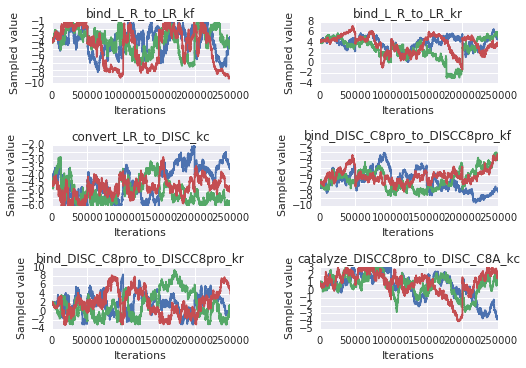

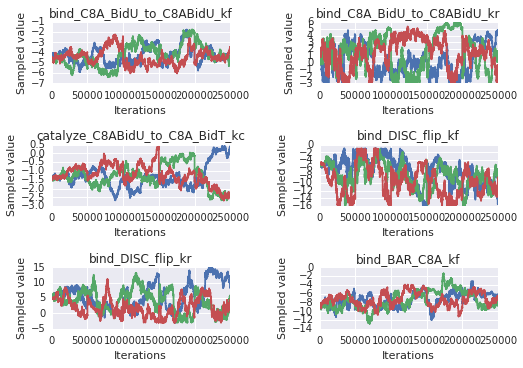

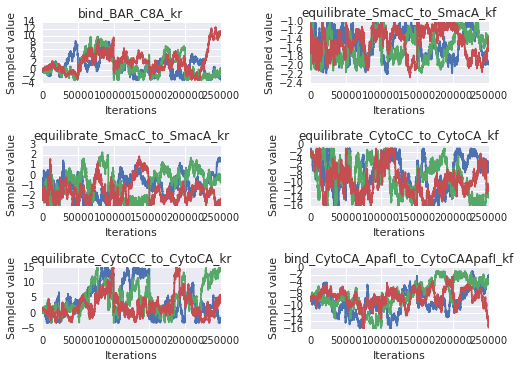

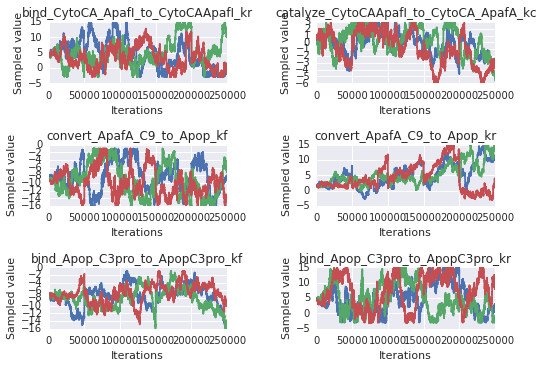

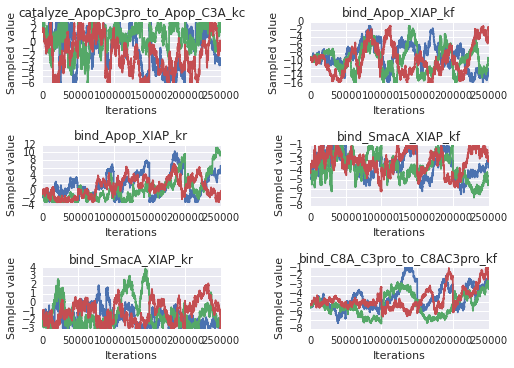

...

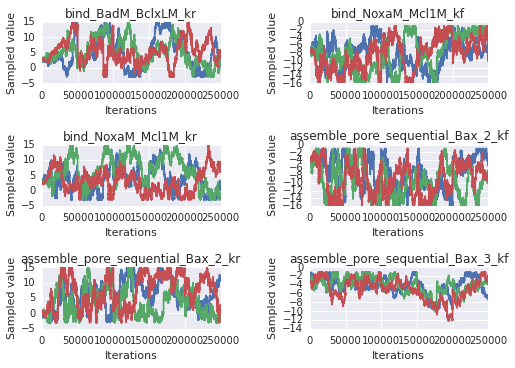

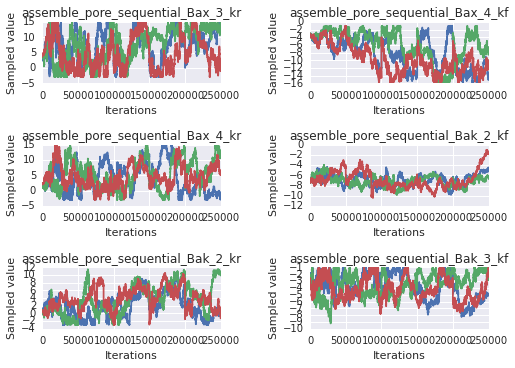

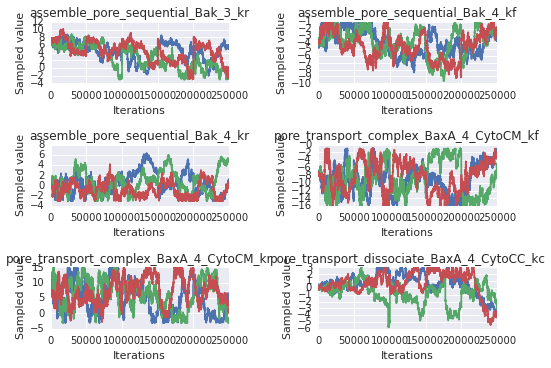

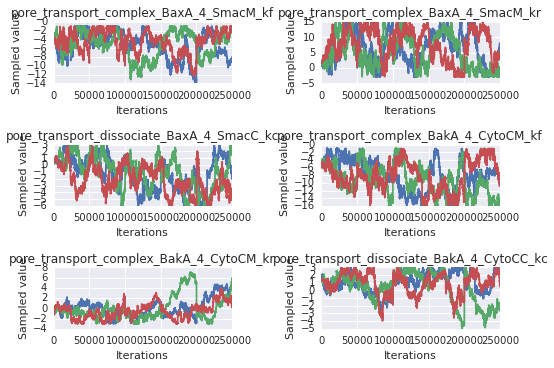

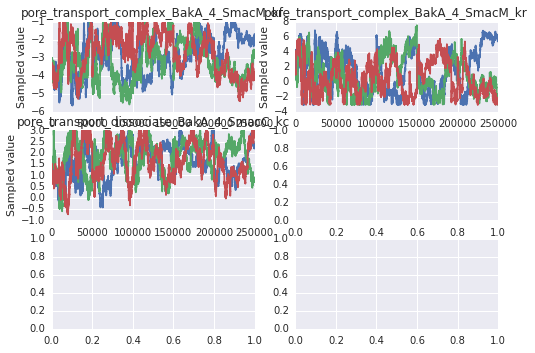

In [20]:
sample_plots(param_trace_dicts['a'])

250000
3
250000


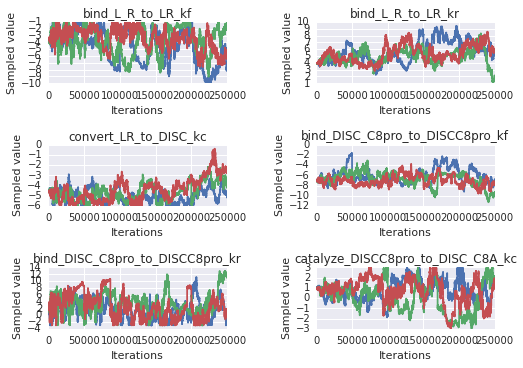

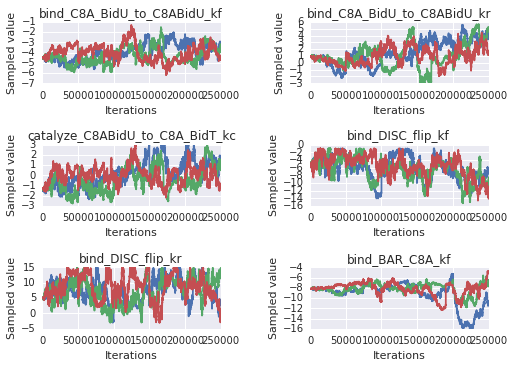

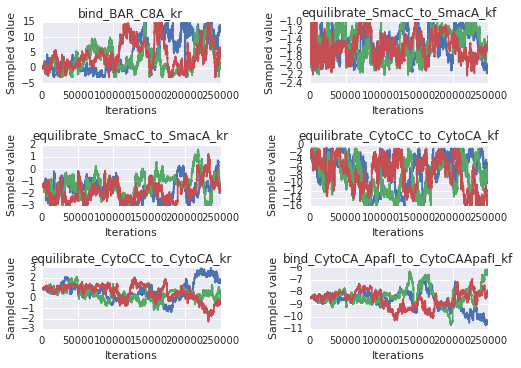

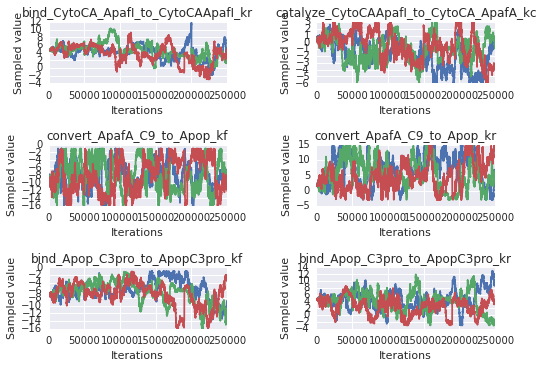

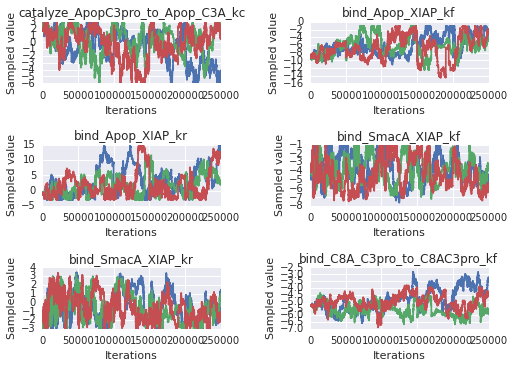

...

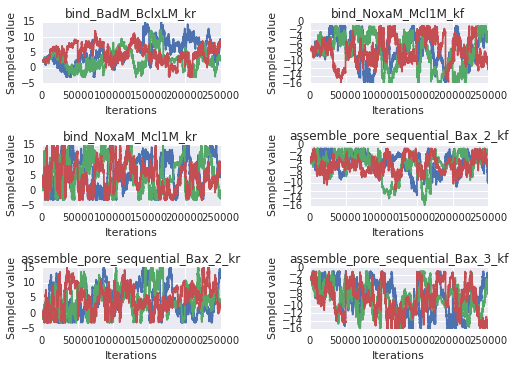

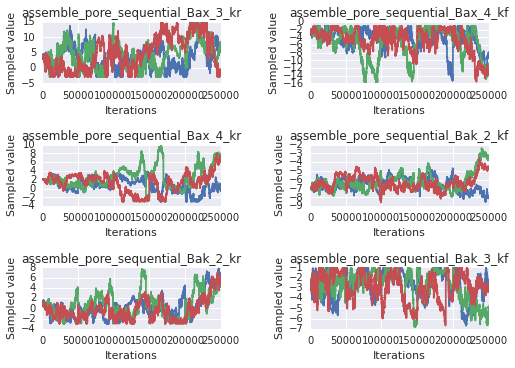

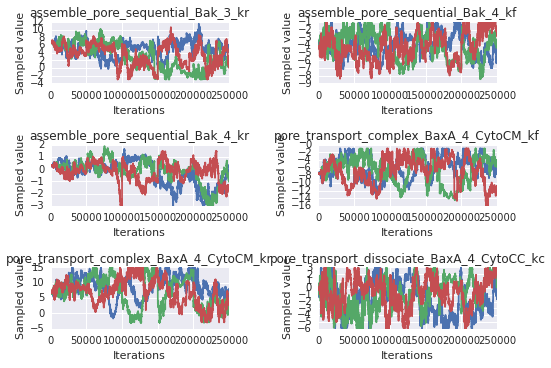

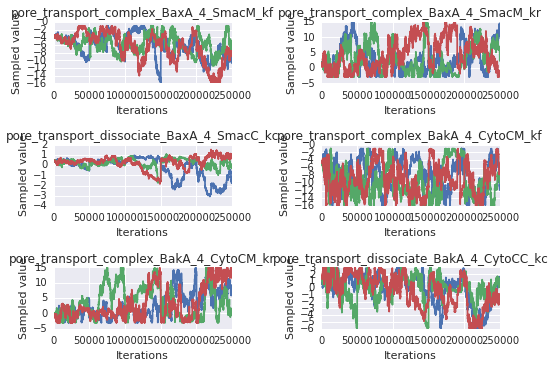

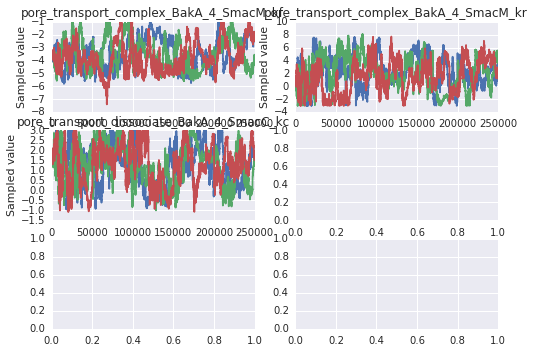

In [21]:
sample_plots(param_trace_dicts['b'])

250000
3
250000


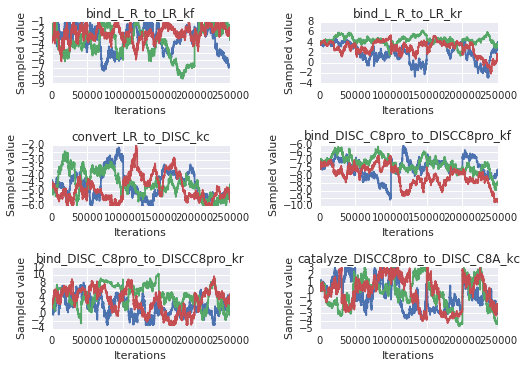

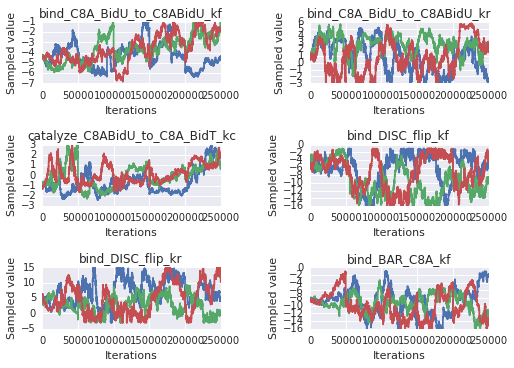

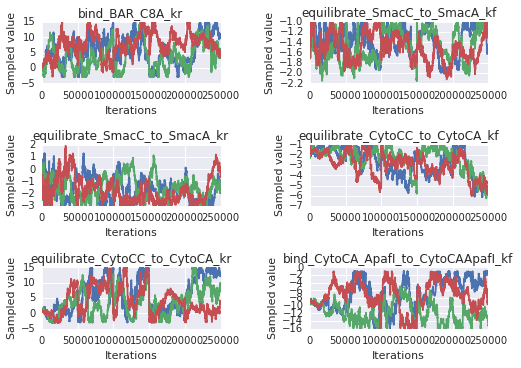

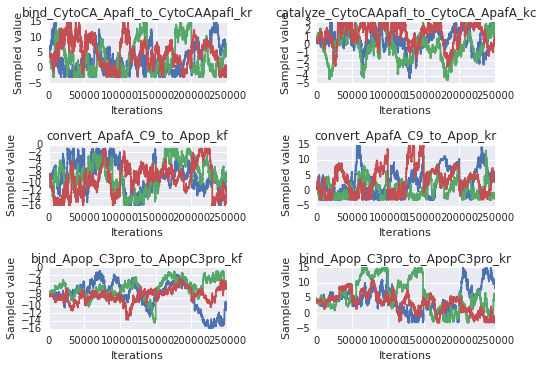

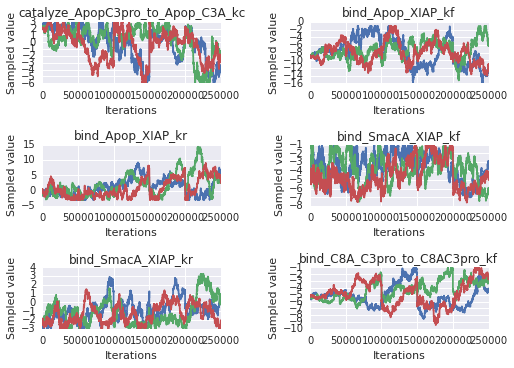

...

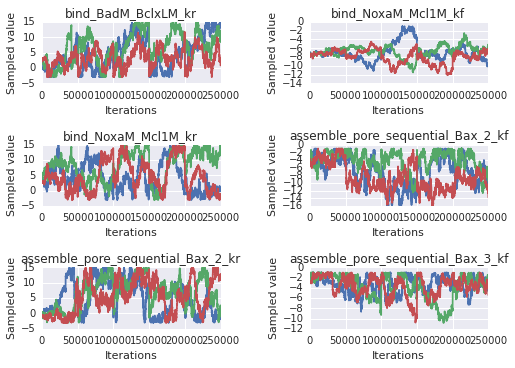

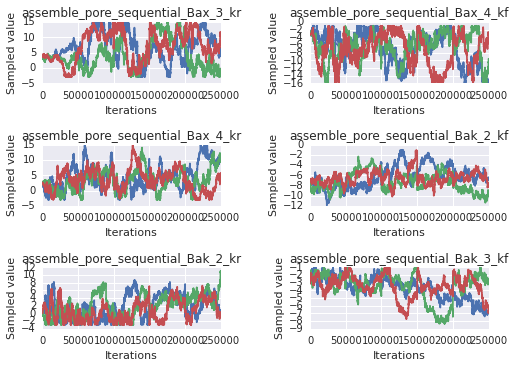

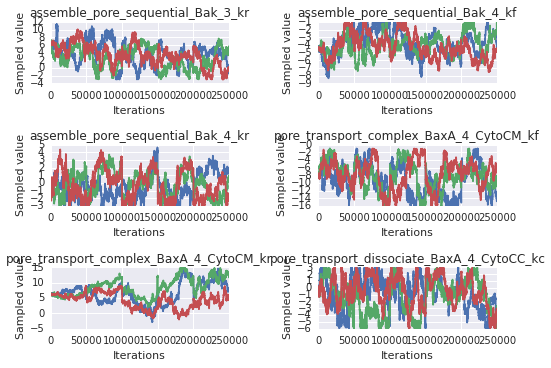

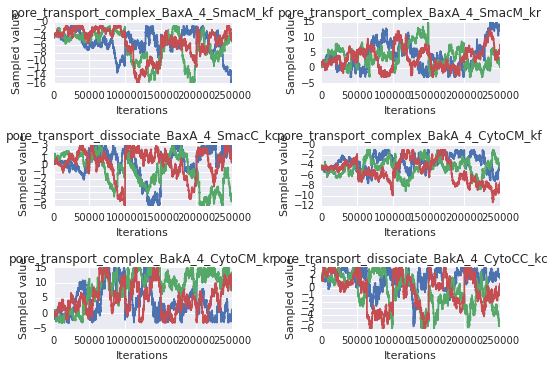

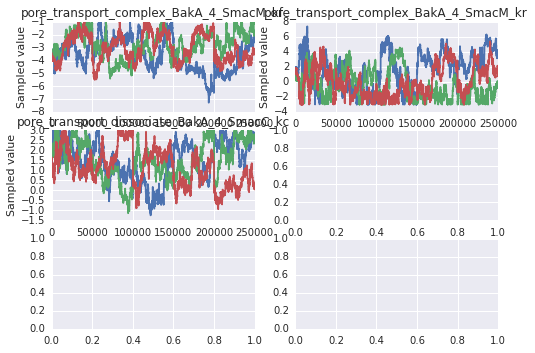

In [22]:
sample_plots(param_trace_dicts['c'])

In [23]:
trace_arr_a = create_trace_matrix(param_trace_dicts['a'], burnin=25000, thin=1)
trace_arr_b = create_trace_matrix(param_trace_dicts['b'], burnin=25000, thin=1)
trace_arr_c = create_trace_matrix(param_trace_dicts['c'], burnin=25000, thin=1)
trace_arr_d = create_trace_matrix(param_trace_dicts['d'], burnin=25000, thin=1)

In [24]:
trace_arr_a_short = create_trace_matrix(param_trace_dicts['a'], burnin=75000, thin=1)
trace_arr_b_short = create_trace_matrix(param_trace_dicts['b'], burnin=75000, thin=1)
trace_arr_c_short = create_trace_matrix(param_trace_dicts['c'], burnin=40000, thin=1)
trace_arr_d_short = create_trace_matrix(param_trace_dicts['d'], burnin=75000, thin=1)

/System/Library/Frameworks/Python.framework/Versions/2.7/Extras/lib/python/matplotlib/pyplot.py:412: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_num_figures`).
  max_open_warning, RuntimeWarning)


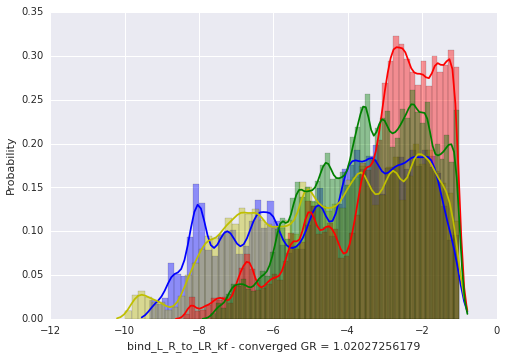

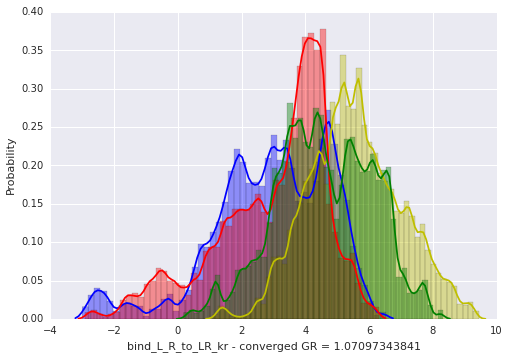

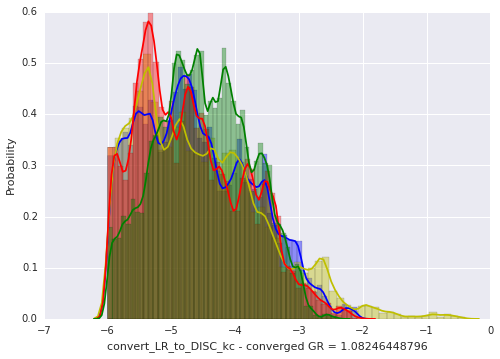

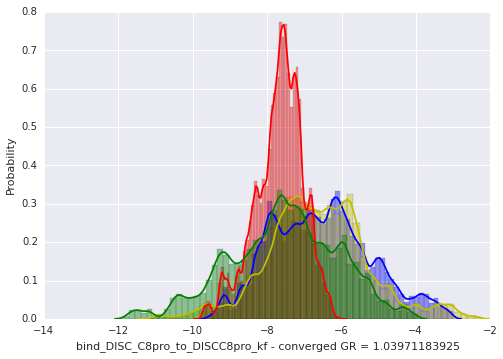

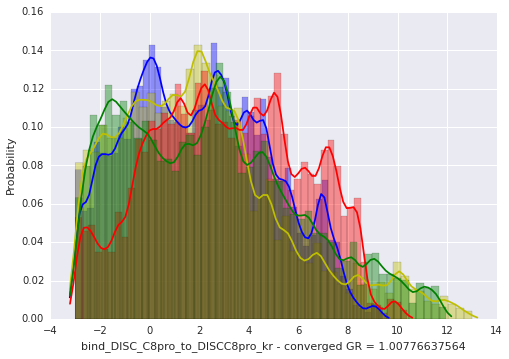

...

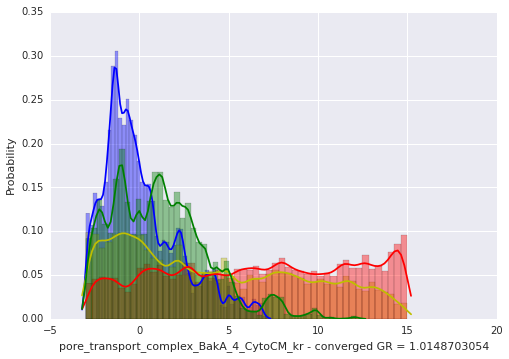

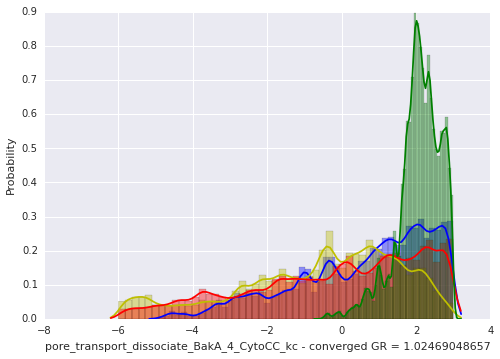

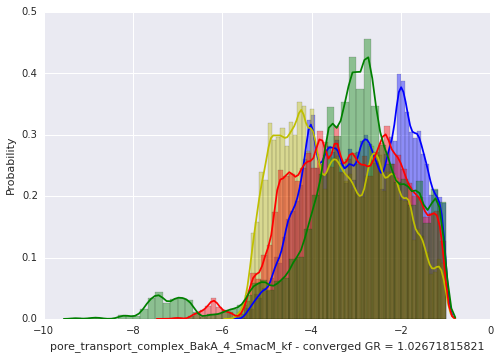

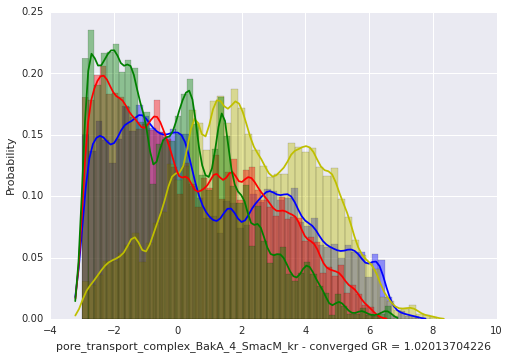

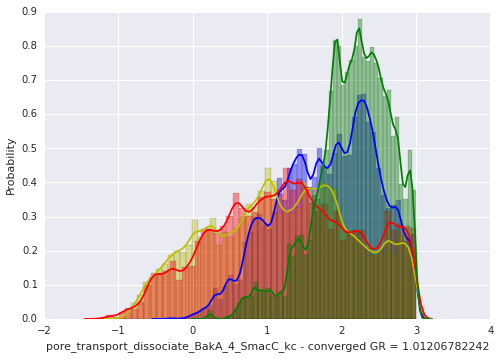

In [25]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    sns.plotting_context('notebook')
    ax = sns.distplot(trace_arr_a_short[:,dim], hist=True, color='b')
    sns.distplot(trace_arr_b_short[:,dim], hist=True, color='y')
    sns.distplot(trace_arr_c_short[:,dim], hist=True, color='r')
    sns.distplot(trace_arr_d_short[:,dim], hist=True, color='g')
    if gelman_rubin_dicts['a'][param_name] < 1.2:
        sns.axlabel(param_name+' - converged GR = '+str(gelman_rubin_dicts['a'][param_name]), 'Probability')
    else:
        sns.axlabel(param_name+' - not converged GR = '+str(gelman_rubin_dicts['a'][param_name]), 'Probability')

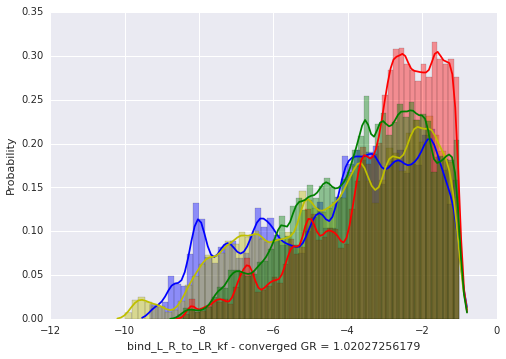

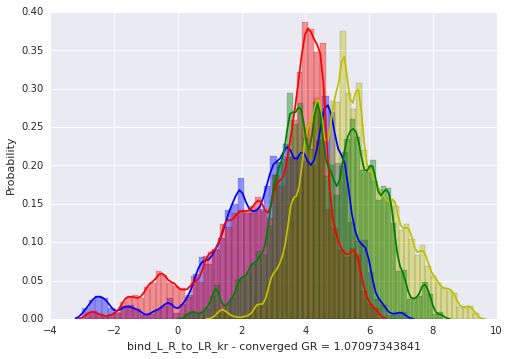

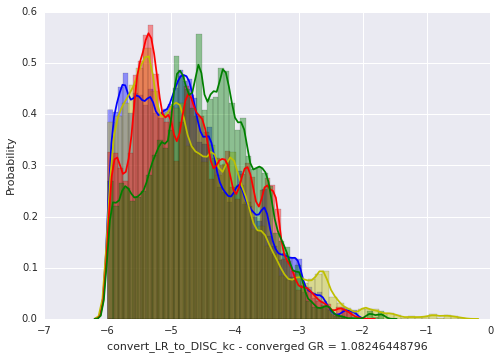

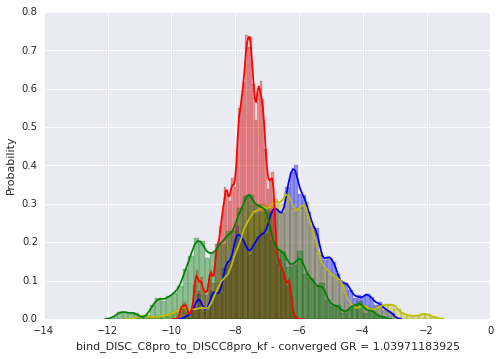

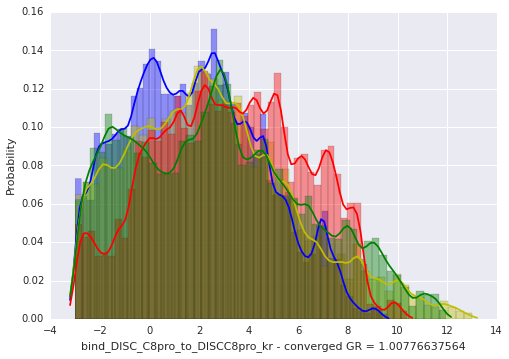

...

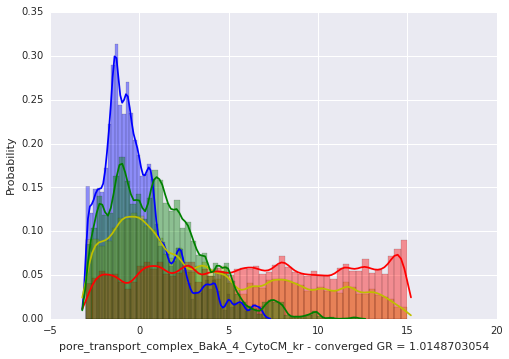

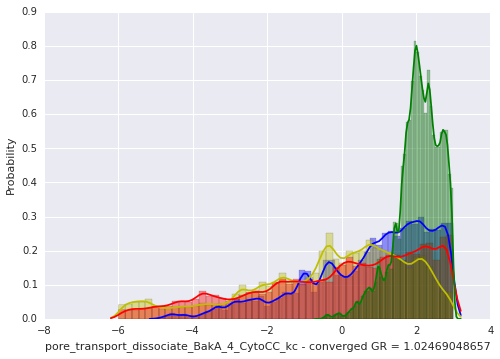

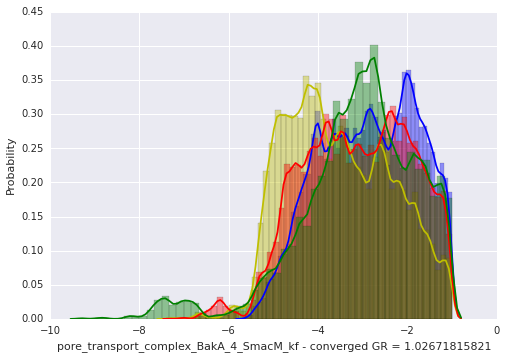

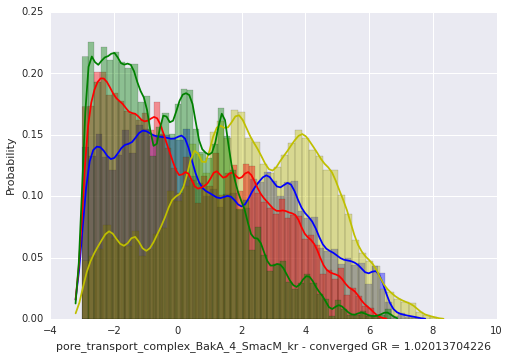

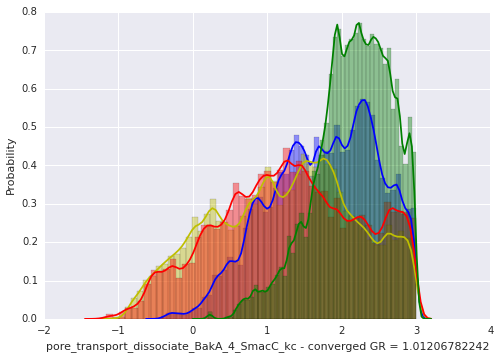

In [26]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    sns.plotting_context('notebook')
    ax = sns.distplot(trace_arr_a[:,dim], hist=True, color='b')
    sns.distplot(trace_arr_b[:,dim], hist=True, color='y')
    sns.distplot(trace_arr_c[:,dim], hist=True, color='r')
    sns.distplot(trace_arr_d[:,dim], hist=True, color='g')
    if gelman_rubin_dicts['a'][param_name] < 1.2:
        sns.axlabel(param_name+' - converged GR = '+str(gelman_rubin_dicts['a'][param_name]), 'Probability')
    else:
        sns.axlabel(param_name+' - not converged GR = '+str(gelman_rubin_dicts['a'][param_name]), 'Probability')

In [27]:
traces['a'][1][:,0]

array([-3.63055501, -3.63055501, -3.63055501, ..., -4.58598333,
       -4.58598333, -4.58598333])

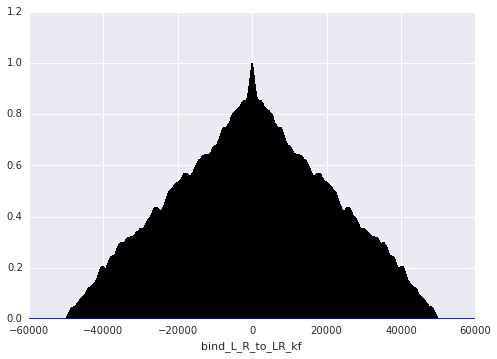

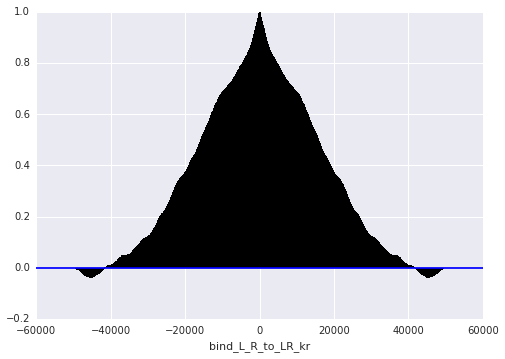

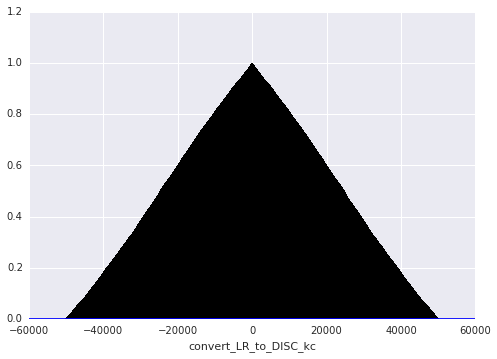

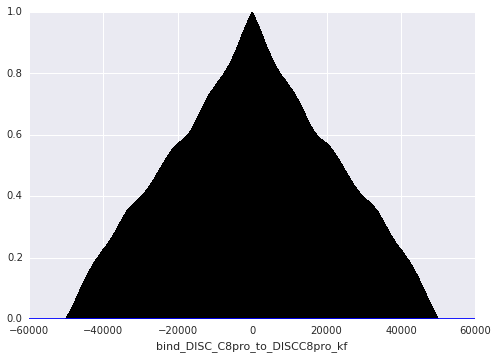

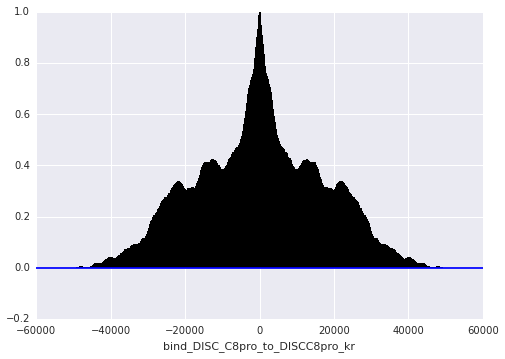

...

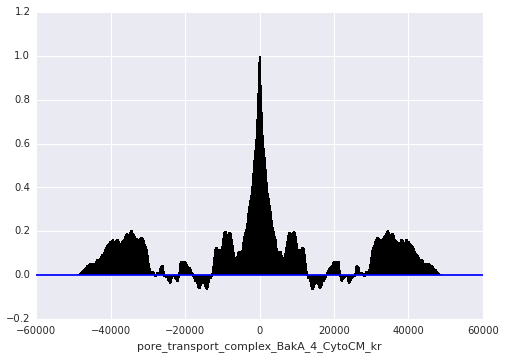

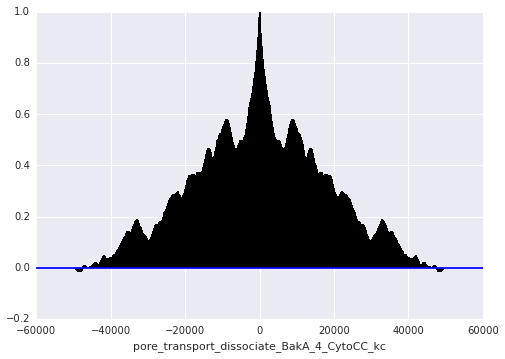

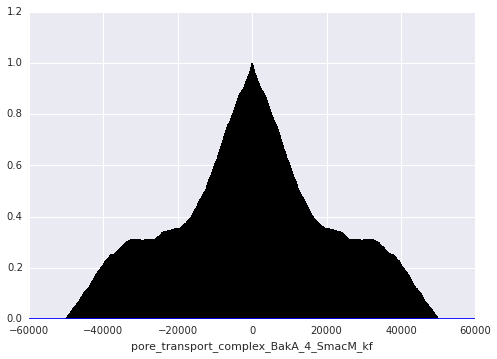

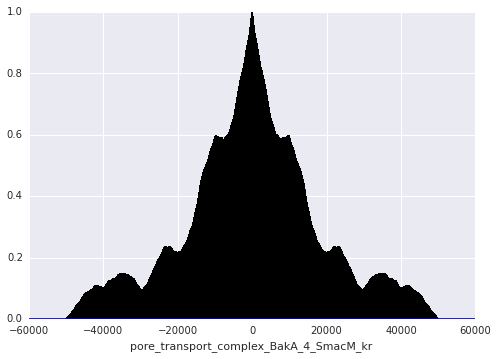

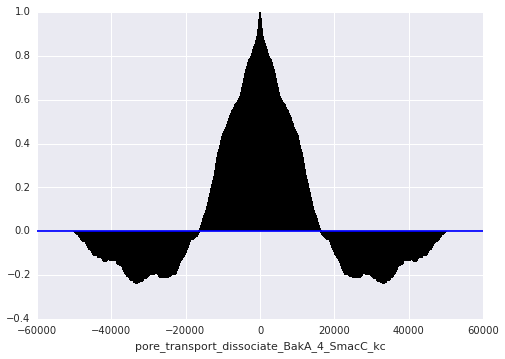

In [37]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    plt.acorr(traces['a'][0][:,dim], maxlags=None)
    plt.xlabel(str(param_name))

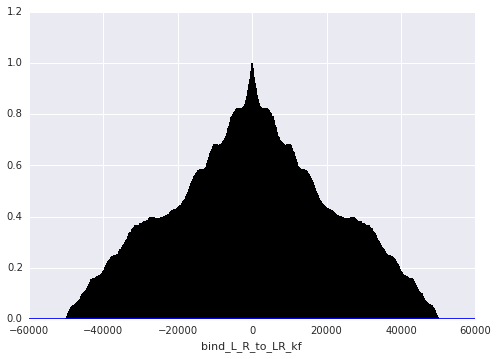

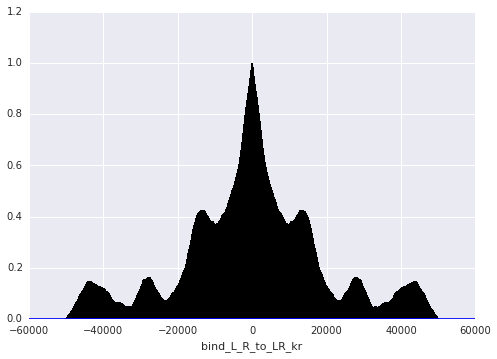

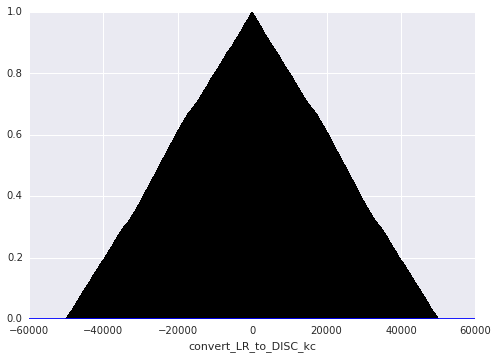

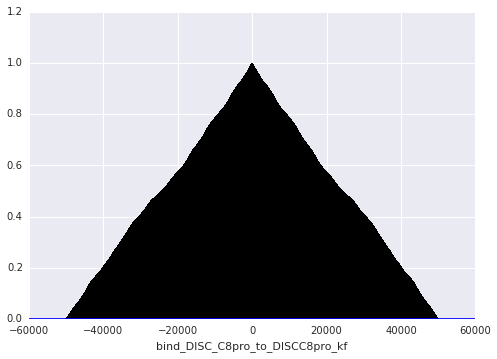

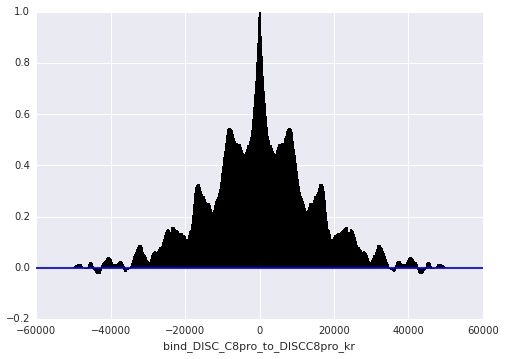

...

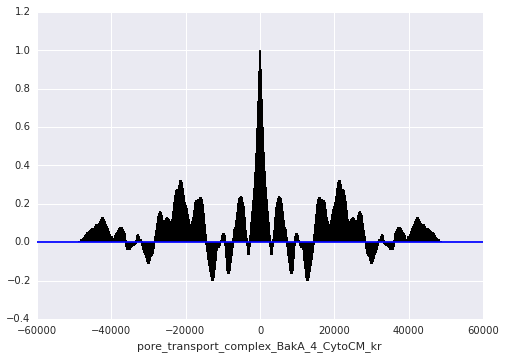

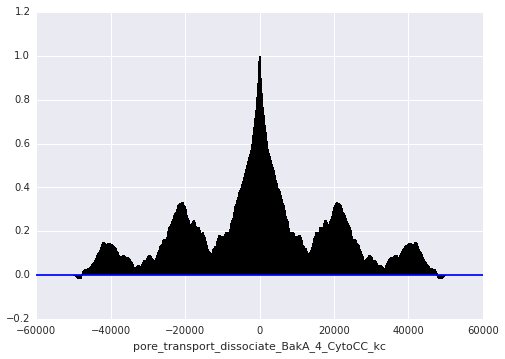

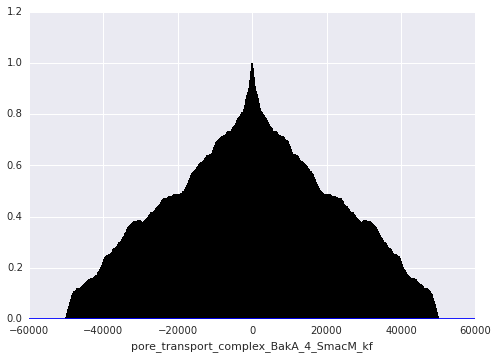

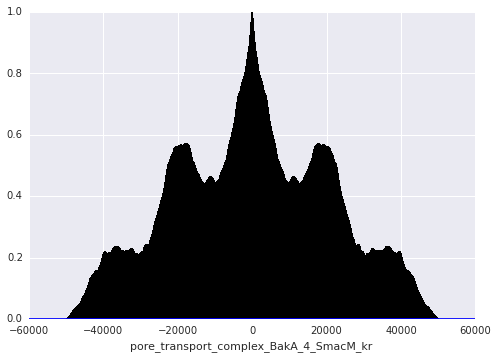

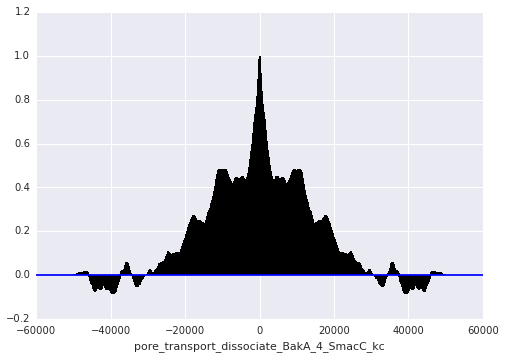

In [38]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    plt.acorr(traces['a'][1][:,dim], maxlags=None)
    plt.xlabel(str(param_name))

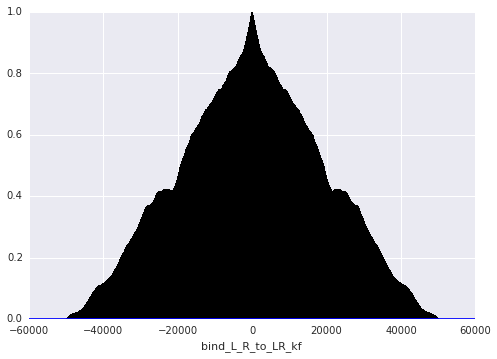

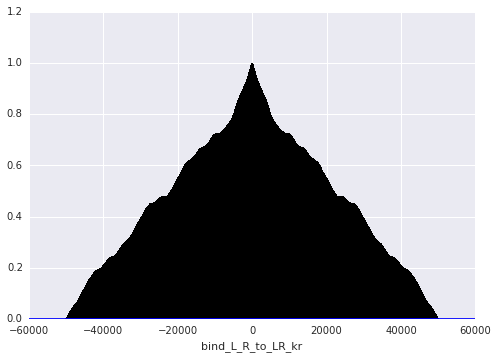

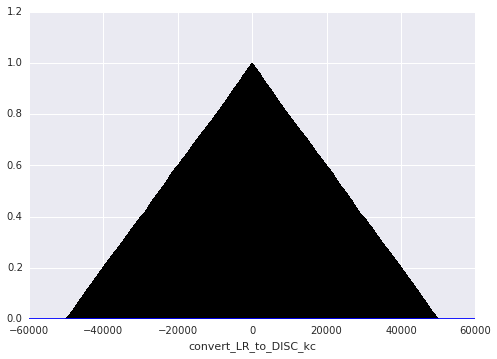

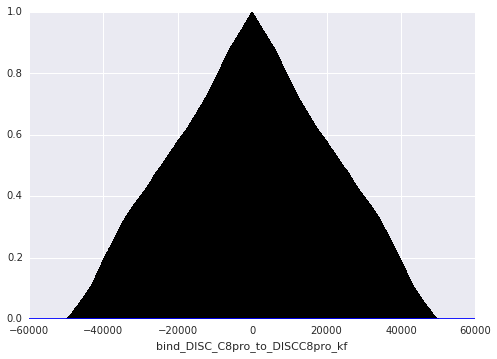

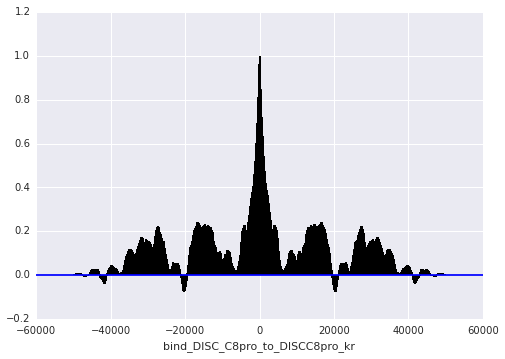

...

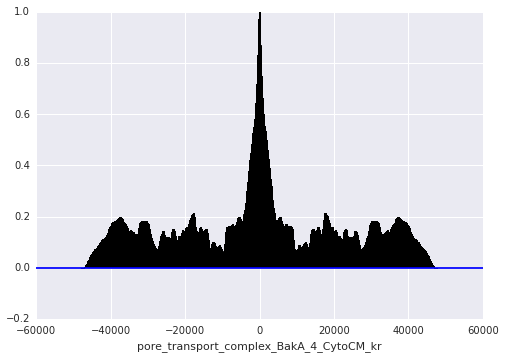

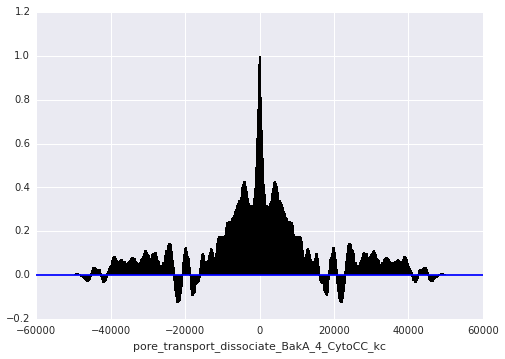

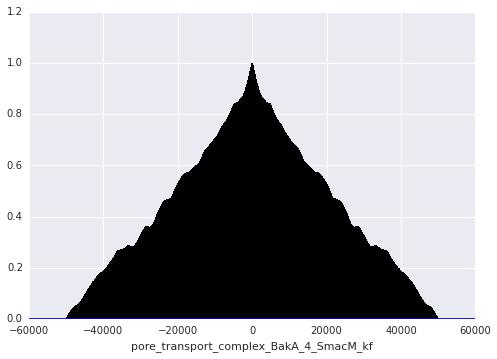

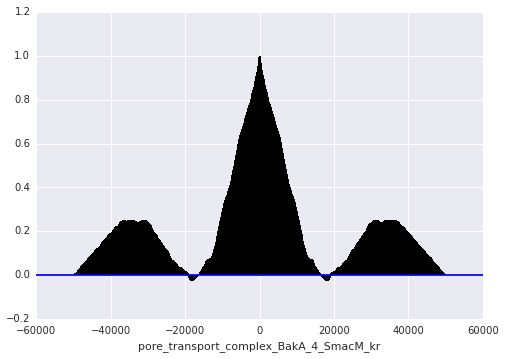

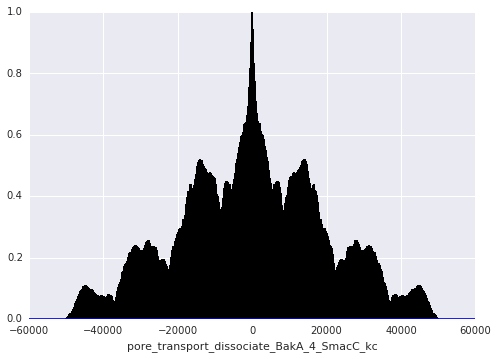

In [39]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    plt.acorr(traces['a'][2][:,dim], maxlags=None)
    plt.xlabel(str(param_name))

In [ ]:
corner(trace_arr_a[:,50:60:], labels=param_trace_dict_a['param_list'][50:60], bins=10)

In [30]:
acceptance_rates = {}
vector_acceptance_rate = {}
running_acceptance_rates = {}
running_acceptance_rates_100window = {}
n_vector_acceptances = {}
n_100windowvec_acceptances = {}
running_acceptance_rates_vec = {}
running_acceptances_rates_vec_100window = {}
n_100window_acceptances = {}
n_acceptances = {}
for run in ['a', 'b', 'c', 'd']:
    acceptance_rates[run] = {}
    vector_acceptance_rate[run] = {}
    running_acceptance_rates[run] = {}
    running_acceptance_rates_100window[run] = {}
    n_vector_acceptances[run] = {}
    n_100windowvec_acceptances[run] = {}
    running_acceptance_rates_vec[run] = {}
    running_acceptances_rates_vec_100window[run] = {}
    n_100window_acceptances[run] = {}
    n_acceptances[run] = {}
    for chain in range(len(traces[run])):
        acceptance_rates[run][chain] = np.zeros((len(traces[run][0][0],)))
        vector_acceptance_rate[run][chain] = 0
        running_acceptance_rates[run][chain] = np.zeros((len(traces[run][0][0]), len(traces[run][0])))
        running_acceptance_rates_100window[run][chain] = np.zeros((len(traces[run][0][0]), 2500))
        n_vector_acceptances[run][chain] = 0
        n_100windowvec_acceptances[run][chain] = 0
        running_acceptance_rates_vec[run][chain] = np.zeros((1, len(traces[run][0])))
        running_acceptances_rates_vec_100window[run][chain] = np.zeros((1, 2500))
        n_100window_acceptances[run][chain] = {}
        n_acceptances[run][chain] = {}
        for dim in range(len(traces[run][chain][0])):
            n_100window_acceptances[run][chain][dim] = 0
            n_acceptances[run][chain][dim] = 0
            for iteration in range(1, len(traces[run][chain])):
                if dim == 0:
                    comparison = traces[run][chain][iteration] == traces[run][chain][iteration-1]
                    if not np.all(comparison):
                        n_vector_acceptances[run][chain] += 1
                        n_100windowvec_acceptances[run][chain] += 1
                    running_acceptance_rates_vec[run][chain][0, iteration] = float(n_vector_acceptances[run][chain])/iteration
                    if iteration % 100 == 0:
                        running_acceptances_rates_vec_100window[run][chain][0, iteration/100] = float(n_100windowvec_acceptances[run][chain])/100
                        n_100windowvec_acceptances[run][chain] = 0
                if traces[run][chain][iteration][dim] != traces[run][chain][iteration-1][dim]:
                    n_acceptances[run][chain][dim] += 1
                    n_100window_acceptances[run][chain][dim] += 1
                running_acceptance_rates[run][chain][dim, iteration] = float(n_acceptances[run][chain][dim])/iteration
        
                if iteration % 100 == 0:
                    running_acceptance_rates_100window[run][chain][dim, iteration/100] = float(n_100window_acceptances[run][chain][dim])/100
                    n_100window_acceptances[run][chain][dim] = 0
            
            acceptance_rates[run][chain][dim] = float(n_acceptances[run][chain][dim])/len(traces[run][chain])
            print 'N acceptances for parameter: ',str(param_trace_dict_a['param_list'][dim]),' = ',str(n_acceptances[run][chain][dim]),' acceptance rate: ',str(acceptance_rates[run][chain][dim])
        print 'n vector acceptances: ',n_vector_acceptances[run][chain],' for run: ',run,' and chain: ',chain
        print 'Acceptance rate for vector: ',float(n_vector_acceptances[run][chain])/len(traces[run][chain]),' for run: ',run,' and chain: ',chain
running_acceptance_rates
running_acceptance_rates_100window
running_acceptance_rates_vec
running_acceptances_rates_vec_100window


N acceptances for parameter:  bind_L_R_to_LR_kf  =  16130  acceptance rate:  0.06452
N acceptances for parameter:  bind_L_R_to_LR_kr  =  15761  acceptance rate:  0.063044
N acceptances for parameter:  convert_LR_to_DISC_kc  =  16032  acceptance rate:  0.064128
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kf  =  15592  acceptance rate:  0.062368
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kr  =  16142  acceptance rate:  0.064568
N acceptances for parameter:  catalyze_DISCC8pro_to_DISC_C8A_kc  =  16054  acceptance rate:  0.064216
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kf  =  16089  acceptance rate:  0.064356
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kr  =  16027  acceptance rate:  0.064108
N acceptances for parameter:  catalyze_C8ABidU_to_C8A_BidT_kc  =  15893  acceptance rate:  0.063572
N acceptances for parameter:  bind_DISC_flip_kf  =  16015  acceptance rate:  0.06406
N acceptances for parameter:  bind_DISC_flip_kr  =  15719  a

{'a': {0: array([[ 0.  ,  0.01,  0.09, ...,  0.04,  0.08,  0.02]]),
  1: array([[ 0.  ,  0.02,  0.12, ...,  0.06,  0.01,  0.08]]),
  2: array([[ 0.  ,  0.03,  0.09, ...,  0.09,  0.07,  0.03]])},
 'b': {0: array([[ 0.  ,  0.02,  0.05, ...,  0.01,  0.02,  0.04]]),
  1: array([[ 0.  ,  0.01,  0.06, ...,  0.03,  0.02,  0.02]]),
  2: array([[ 0.  ,  0.  ,  0.09, ...,  0.03,  0.05,  0.03]])},
 'c': {0: array([[ 0.  ,  0.04,  0.1 , ...,  0.04,  0.07,  0.06]]),
  1: array([[ 0.  ,  0.05,  0.09, ...,  0.09,  0.07,  0.07]]),
  2: array([[ 0.  ,  0.04,  0.09, ...,  0.04,  0.03,  0.04]])},
 'd': {0: array([[ 0.  ,  0.01,  0.07, ...,  0.  ,  0.03,  0.  ]]),
  1: array([[ 0.  ,  0.04,  0.12, ...,  0.01,  0.04,  0.01]]),
  2: array([[ 0.  ,  0.03,  0.08, ...,  0.05,  0.03,  0.01]])}}

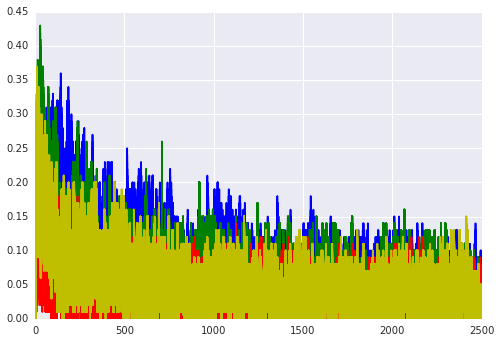

In [32]:
for run in ['a', 'b', 'c', 'd']:
    for chain in range(len(traces[run])):
        for dim in range(105):
            if run == 'a':
                plt.plot(range(2500), running_acceptance_rates_100window[run][chain][dim, :], 'b')
            elif run == 'b':
                plt.plot(range(2500), running_acceptance_rates_100window[run][chain][dim, :], 'g')
            elif run == 'c':
                plt.plot(range(2500), running_acceptance_rates_100window[run][chain][dim, :], 'r')
            elif run == 'd':
                plt.plot(range(2500), running_acceptance_rates_100window[run][chain][dim, :], 'y')

In [33]:
adapted_crossover_vals = {}
adapted_gamma_vals = {}
joint_probs = {}
for run in ['a', 'b', 'c', 'd']:
    adapted_gamma_vals[run] = np.load('earm_dreamzs_3chain_uniform_gammalevels_25000burnin_'+run+'_DREAM_chain_adapted_gammalevelprob.npy')
    adapted_crossover_vals[run] = np.load('earm_dreamzs_3chain_uniform_gammalevels_25000burnin_'+run+'_DREAM_chain_adapted_crossoverprob.npy')
    #joint_probs[run] = adapted_crossover_vals[run]*[adapted_gamma_vals[run][level] for level in range(len(adapted_gamma_vals[run]))]


In [34]:
adapted_crossover_vals

{'a': array([ 0.37195137,  0.4049938 ,  0.22305483]),
 'b': array([  5.53032197e-06,   5.20635171e-01,   4.79359299e-01]),
 'c': array([  8.20218043e-01,   6.68955674e-18,   1.79781957e-01]),
 'd': array([ 0.1452162 ,  0.28356947,  0.57121433])}

In [35]:
adapted_gamma_vals

{'a': array([  1.16493786e-04,   4.45425830e-01,   2.20046636e-01,
          3.34411040e-01]),
 'b': array([ 0.34614983,  0.38232045,  0.21075939,  0.06077033]),
 'c': array([  1.03701977e-06,   5.54351336e-01,   2.27289804e-01,
          2.18357823e-01]),
 'd': array([  7.33978282e-01,   3.40478609e-06,   1.16290219e-01,
          1.49728094e-01])}